In [1]:
import plotly.express as px
import pandas as pd
import pickle
import numpy as np
from os import listdir
import matplotlib.pyplot as plt

In [2]:
es_array_paths = [f for f in listdir("/github/data-mining-2022/Hitos/H3") if ("es" in f) and ("pickle" in f) and ("dm" in f or "report" in f or "projection" in f)]

In [3]:
path =  "../../Data/train/df_es_train.pickle"
df_es_train = pickle.load(open(path, "rb"))

In [4]:
sample_index_es = np.random.RandomState(0).choice(range(df_es_train.shape[0]), 20000)
labels = df_es_train.iloc[sample_index_es]["label"].values

In [5]:
es_results = []
for f in es_array_paths:
    if "report" in f:
        se, cm = f.replace("_es_report.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        for k, v in dict_m["metricas"].items():
            o = {"Vector": se, "Clustering": cm, "Metrica": k, "Valor": v}
            es_results.append(o)

In [6]:
df_es_results = pd.DataFrame(es_results)
df_es_results

,Vector,Clustering,Metrica,Valor
0,beto,dbscan,Silhouette,-0.053405
1,beto,dbscan,Rand score,0.092397
2,beto,dbscan,Mutual information,0.000726
3,beto,dbscan,Homogeneity,0.000365
4,beto,dbscan,Completeness,0.100454
...,...,...,...,...
91,w2v,kmeans,Rand score,0.819727
92,w2v,kmeans,Mutual information,0.026681
93,w2v,kmeans,Homogeneity,0.025777
94,w2v,kmeans,Completeness,0.027650


In [7]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "Silhouette"], x="Clustering", y="Valor", color="Vector",
                width=600, height=400)
fig.update_layout(
    title="Silhouette: ES",
    barmode='group')
fig.show(renderer="notebook")

In [8]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "Rand score"], x="Clustering", y="Valor", color="Vector",
            width=600, height=400)
fig.update_layout(
    title="Rand score: ES",
    barmode='group')
fig.show(renderer="notebook")

In [9]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "Mutual information"], x="Clustering", y="Valor", color="Vector",
    width=600, height=400)
fig.update_layout(
    title="Mutual information: ES",
    barmode='group')
fig.show(renderer="notebook")

In [10]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "Homogeneity"], x="Clustering", y="Valor", color="Vector",
    width=600, height=400)
fig.update_layout(
    title="Homogeneity: ES",
    barmode='group')
fig.show(renderer="notebook")

In [11]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "Completeness"], x="Clustering", y="Valor", color="Vector",
            width=600, height=400)
fig.update_layout(
    title="Completeness: ES",
    barmode='group')
fig.show(renderer="notebook")

In [12]:
fig = px.bar(df_es_results[df_es_results["Metrica"] == "V-measure"], x="Clustering", y="Valor", color="Vector",
            width=600, height=400)
fig.update_layout(
    title="V-measure: ES",
    barmode='group')
fig.show()

In [13]:
es_dm = []
for f in es_array_paths:
    if "dm" in f:
        se, cm = f.replace("_es_dm.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        o = [(se, cm), dict_m]
        es_dm.append(o)

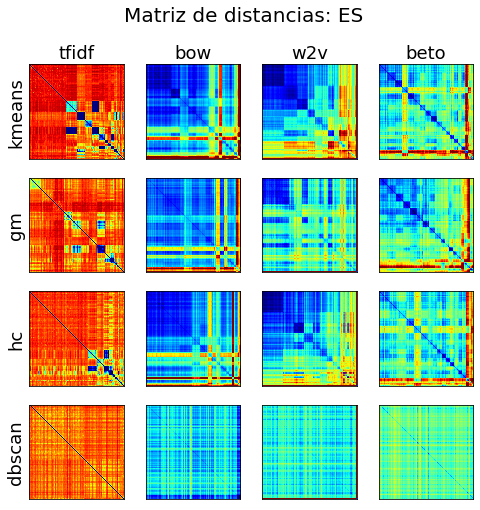

In [28]:
fig, ax = plt.subplots(4, 4, figsize=(8, 8))
q1=0.05
x0=-70
scale=1.02
num_tags=5
for k, v in enumerate(es_dm):
    v0, v1 = v
    j, i = ["tfidf", "bow", "w2v", "beto"].index(v0[0]), ["kmeans", "gm", "hc", "dbscan"].index(v0[1])
    if j==2: q3=0.95
    else: q3=0.95
    vmin = np.quantile(v1["matriz_distancias"].flatten(), q1)
    vmax = np.quantile(v1["matriz_distancias"].flatten(), q3)
    ax[i,j].imshow(v1["matriz_distancias"], cmap="jet", vmin=vmin, vmax=vmax)
    ax[i,j].set_yticks([])
    ax[i,j].set_xticks([])
    if i==0:
        ax[i,j].set_title(v0[0], size=18)
    if j==0:
        ax[i,j].set_ylabel(v0[1], size=18)
plt.suptitle("Matriz de distancias: ES", size=20);
fig.savefig('MD_ES.jpg', bbox_inches='tight')

In [15]:
es_prjt = {"pca": {}, "tsne": {}, "umap": {}}
for f in es_array_paths:
    if "projection" in f:
        se, rd = f.split("_")[:2]
        reduced = pickle.load(open(f, "rb"))["reduced"]
        es_prjt[rd][se] = reduced

In [16]:
es_clusters = {"kmeans": {}, "hc": {}, "gm": {}, "dbscan": {}}
for f in es_array_paths:
    if "report" in f:
        se, cm = f.replace("_es_report.pickle", "").split("_")
        dict_m = pickle.load(open(f, "rb"))
        es_clusters[cm][se] = dict_m["clusters"]

In [17]:
plot_sample_index_es = np.random.RandomState(0).choice(range(20000), 1000)

In [18]:
def plot_prj(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(4, 4, figsize=(10, 10))
    for i, cm in enumerate(["kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "beto"]):
            clusters = es_clusters[cm][se][plot_sample_index_es]
            x = es_prjt[prj][se][plot_sample_index_es,0]
            y = es_prjt[prj][se][plot_sample_index_es,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: ES", size=20);
    fig.savefig(f'{prj.upper()}_ES.jpg', bbox_inches='tight')

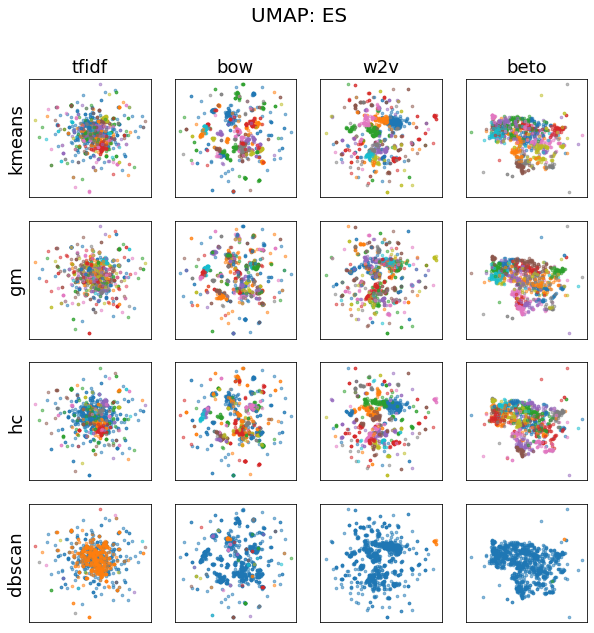

In [19]:
plot_prj("umap")

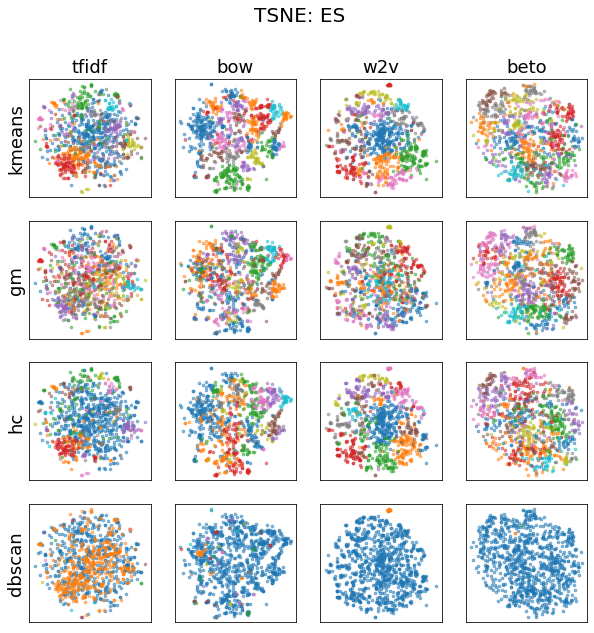

In [20]:
plot_prj("tsne")

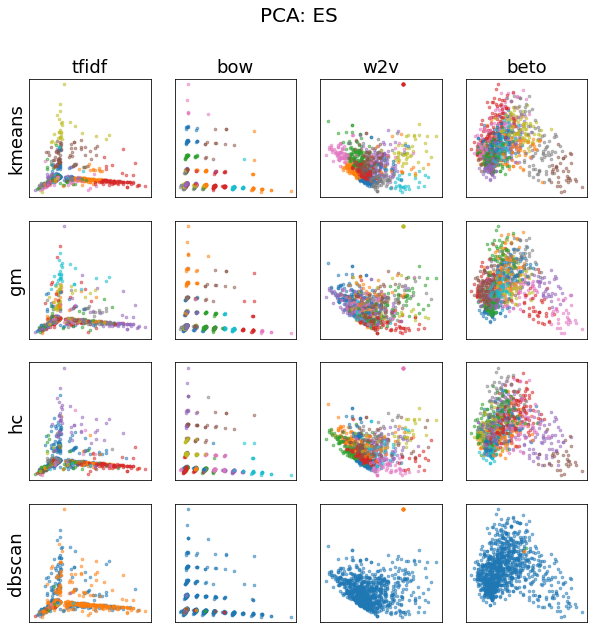

In [21]:
plot_prj("pca")

In [24]:
def plot_prj_and_labels(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(5, 4, figsize=(10, 10))
    for i, cm in enumerate(["emoji", "kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "beto"]):
            clusters = es_clusters[cm][se][plot_sample_index_es] if i>0 else labels[plot_sample_index_es]
            x = es_prjt[prj][se][plot_sample_index_es,0]
            y = es_prjt[prj][se][plot_sample_index_es,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: ES", size=20);
#     fig.savefig(f'{prj.upper()}_US.jpg', bbox_inches='tight')

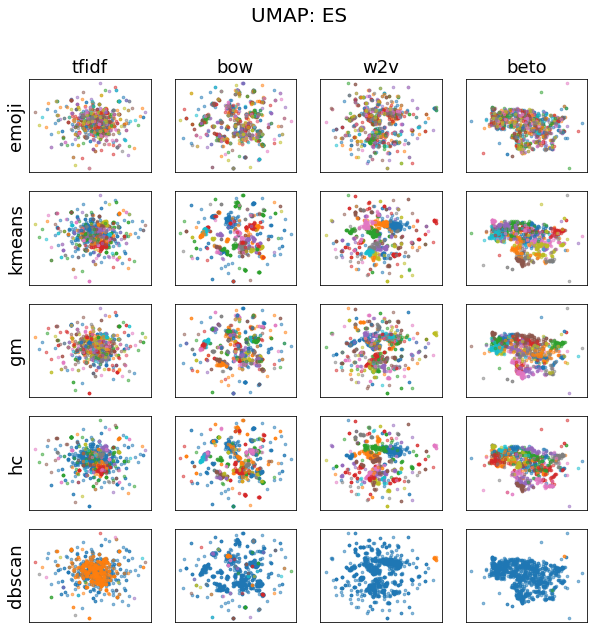

In [25]:
plot_prj_and_labels("umap")

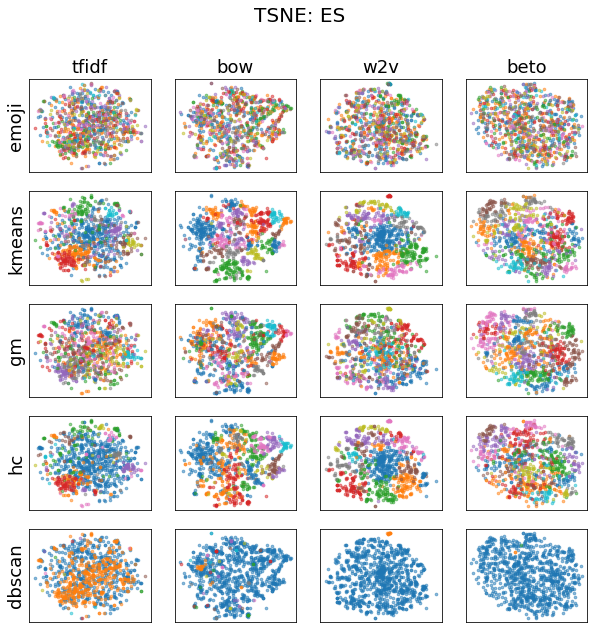

In [26]:
plot_prj_and_labels("tsne")

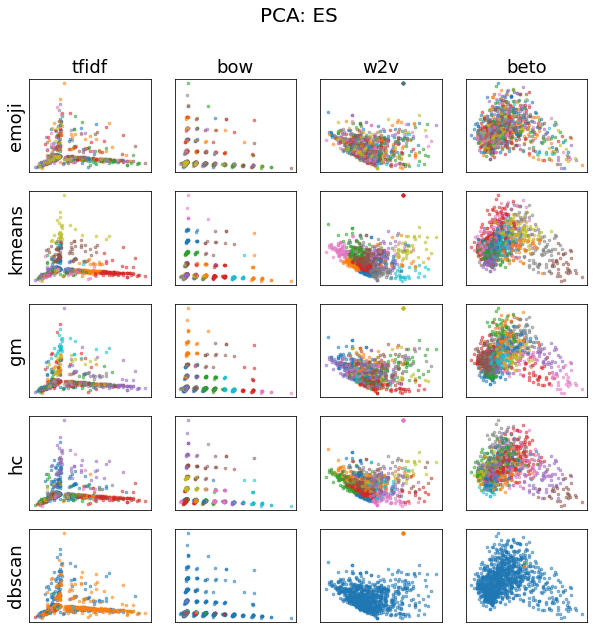

In [27]:
plot_prj_and_labels("pca")